In [3]:
import cv2
import numpy as np
import os
import math

In [4]:
def get_images_from_video(video_path, output_folder, start_time_sec=0, end_time_sec=None):

    desired_fps = 5         # Desired frame extraction rate (Hz)

    # Create output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Open the video file
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        raise IOError(f"Cannot open video file: {video_path}")

    # Retrieve video properties
    fps = cap.get(cv2.CAP_PROP_FPS)
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    print(f"Video FPS: {fps:.2f}, Total Frames: {total_frames}")

    # Convert start and end times to frame indices
    start_frame = int(start_time_sec * fps)
    end_frame = int(end_time_sec * fps)
    if end_frame > total_frames:
        end_frame = total_frames
    print(f"Processing frames from {start_frame} to {end_frame}")

    # Compute the step size for extracting frames at approximately desired_fps
    step = int(round(fps / desired_fps))
    if step < 1:
        step = 1
    print(f"Extracting every {step} frame(s) to achieve approximately {desired_fps} Hz")

    frame_idx = start_frame
    saved_frame_count = 0

    while frame_idx < end_frame:
        # Set the video position to the desired frame
        cap.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
        ret, frame = cap.read()
        if not ret:
            break
        
        output_filename = os.path.join(output_folder, f"frame_{saved_frame_count:05d}.jpg")
        cv2.imwrite(output_filename, frame)
        print(f"Saved frame {saved_frame_count} (frame index: {frame_idx}) to {output_filename}")
        
        saved_frame_count += 1
        frame_idx += step

    cap.release()

In [9]:
import os
import cv2

# -------------------------
# User-defined parameters
# -------------------------

folder_nums = [0, 1, 2, 3, 4.1, 4.2, 5, 6.1, 6.2, 7, 8.1, 8.2, 9]  # List of folder numbers to process
# folder_nums = [4.1]
# Loop through each folder number and process the corresponding video
for folder_num in folder_nums:

    print(f"Processing folder number: {folder_num}")

    if folder_num == 0:
        # num 0
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_0_folder/GX013939.MP4"  # Video file path
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_0/images"  # Folder to save images
        start_time_sec = 50.0   # Start time in seconds
        end_time_sec = 78.0     # End time in seconds
    elif folder_num == 1:
        # num 1
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_1_folder/GX013940.MP4"
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_1/images"  # Folder to save images
        start_time_sec = 60.0
        end_time_sec = 78.0
    elif folder_num == 2:
        # num 2
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_2_folder/GX013942.MP4"
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_2/images"
        start_time_sec = 79.0
        end_time_sec = 89.0
    elif folder_num == 3:
        # num 3
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_3_folder/GH013301.MP4"
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_3/images"
        start_time_sec = 37.0
        end_time_sec = 46.0
    elif folder_num == 4.1:
        # num 4
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_4_folder/GX013946.MP4"
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_4/images-part1"
        start_time_sec = 36.0
        end_time_sec = 44.0
    elif folder_num == 4.2:
        # num 4 - part 2
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_4_folder/GH013304.MP4"
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_4/images-part2"
        start_time_sec = 20.0
        end_time_sec = 31.0
    elif folder_num == 5:
        # num 5
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_5_folder/GH013305.MP4"
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_5/images"
        start_time_sec = 39.0
        end_time_sec = 52.0
    elif folder_num == 6.1:
        # num 6 - part 1
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_6_folder/GX013948.MP4"
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_6/images-part1"
        start_time_sec = 208.0
        end_time_sec = 230.0
    elif folder_num == 6.2:
        # num 6 - part 2
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_6_folder/GH013306.MP4"
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_6/images-part2"
        start_time_sec = 33.0
        end_time_sec = 53.0
    elif folder_num == 7:
        # num 7
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_7_folder/GH013307.MP4"
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_7/images"
        start_time_sec = 37.0
        end_time_sec = 48.0
    elif folder_num == 8.1:
        # num 8 - part 1
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_8_folder/GX013950.MP4"
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_8/images-part1"
        start_time_sec = 45.0
        end_time_sec = 62.0
    elif folder_num == 8.2:
        # num 8 - part 2
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_8_folder/GH013308.MP4"
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_8/images-part2"
        start_time_sec = 29.0
        end_time_sec = 44.0
    elif folder_num == 9:
        # num 9
        video_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dyn_sta/num_9_folder/GH013310.MP4"
        output_folder = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_9/images"
        start_time_sec = 35.0
        end_time_sec = 45.0
        
    get_images_from_video(video_path, output_folder, start_time_sec, end_time_sec)



Processing folder number: 4.1
Video FPS: 59.94, Total Frames: 4239
Processing frames from 2157 to 2637
Extracting every 12 frame(s) to achieve approximately 5 Hz
Saved frame 0 (frame index: 2157) to /home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_4/images-part1/frame_00000.jpg
Saved frame 1 (frame index: 2169) to /home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_4/images-part1/frame_00001.jpg
Saved frame 2 (frame index: 2181) to /home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_4/images-part1/frame_00002.jpg
Saved frame 3 (frame index: 2193) to /home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_4/images-part1/frame_00003.jpg
Saved frame 4 (frame index: 2205) to /home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_4/images-part1/frame_00004.jpg
Saved frame 5 (frame index: 2217) to /home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_4/images-part1/frame_00005.jpg
Save

/tmp/ipykernel_1995214/3771249891.py:262: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


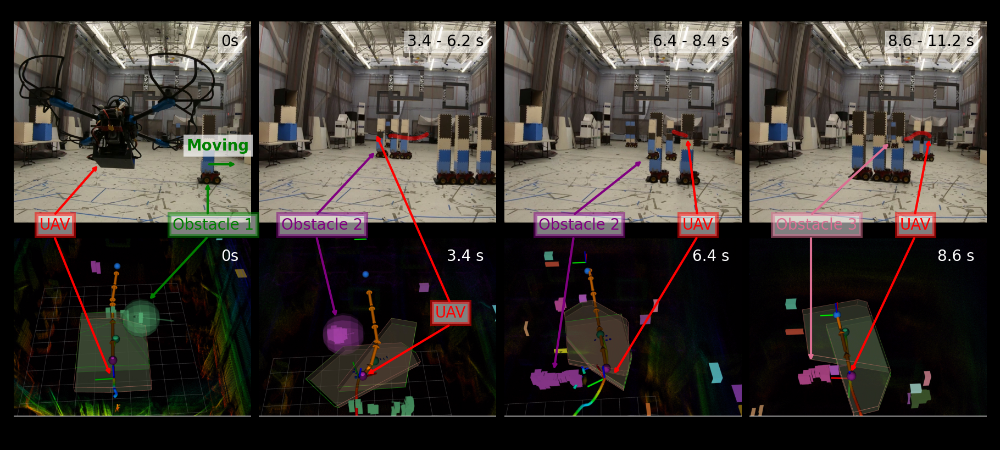

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from pathlib import Path
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Prompt for input and output folder paths
output_folder = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dynamic/images"
output_path = Path(output_folder)
output_path.mkdir(parents=True, exist_ok=True)

images = [
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dynamic/images/num_5_goodnoted/frame_00018.jpg",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dynamic/images/num_5_rviz/uav_hw_dynamic_rviz_num_5_1.png",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dynamic/images/num_5_goodnoted/frame_0035-0049.jpg",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dynamic/images/num_5_rviz/uav_hw_dynamic_rviz_num_5_2.png",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dynamic/images/num_5_goodnoted/frame_0050-0060.jpg",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dynamic/images/num_5_rviz/uav_hw_dynamic_rviz_num_5_3.png",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dynamic/images/num_5_goodnoted/frame_0061-0074.jpg",
    "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dynamic/images/num_5_rviz/uav_hw_dynamic_rviz_num_5_4.png",
]

time_interval = 1 / 5  # 5Hz
time_texts = ["0s",
                "0s",
                f"{((35-18) * time_interval) + 0.0:.1f} - {((49-18) * time_interval) + 0.0:.1f} s",
                f"{((35-18) * time_interval) + 0.0:.1f} s",
                f"{((50-18) * time_interval) + 0.0:.1f} - {((60-18) * time_interval) + 0.0:.1f} s",
                f"{((50-18) * time_interval) + 0.0:.1f} s",
                f"{((61-18) * time_interval) + 0.0:.1f} - {((74-18) * time_interval) + 0.0:.1f} s",
                f"{((61-18) * time_interval) + 0.0:.1f} s"]

# Create a figure with 2 rows and 4 columns
fig = plt.figure(figsize=(18, 8))
gs = gridspec.GridSpec(2, 4, height_ratios=[1, 1], width_ratios=[1, 1, 1, 1])

# Plot each image in the grid
for idx in range(len(images)):

    img = mpimg.imread(str(images[idx]))
    ax = fig.add_subplot(gs[idx % 2, idx // 2])

    # if idx == 0:
    #     # Add a dot to indicate the start point
    #     ax.scatter(0.18, 0.2, s=100, c='red', marker='o', transform=ax.transAxes)
    #     # add a red text "start point"
    #     ax.text(0.1, 0.4, "Start",
    #             ha='left', va='center', transform=ax.transAxes,
    #             bbox = dict(facecolor='white', alpha=0.5, edgecolor='white'),
    #             fontsize=20, color='red')

    # if idx == len(images) - 2:
    #     # Add a dot to indicate the end point
    #     ax.scatter(0.43, 0.65, s=100, c='blue', marker='o', transform=ax.transAxes)
    #     # add a blue text "end point"
    #     ax.text(0.38, 0.82, "Goal",
    #             ha='left', va='center', transform=ax.transAxes,
    #             bbox = dict(facecolor='white', alpha=0.5, edgecolor='white'),
    #             fontsize=20, color='blue')
        
    # frame_00018.jpg is (2160,3840,3) sized - and needs to be resized
    if idx == 0:
        desired_width = 1668  # width of the smaller image
        desired_height = 938  # height of the smaller image
        img = cv2.resize(img, (desired_width, desired_height))

    # 1st row images (go-pro) need to be cropped
    if idx % 2 == 0:
        # right images (go-pro) need to be cropped
        img = img[100:img.shape[0] - 100, 300:img.shape[1] - 500]
        # add white text of time stamp
        ax.text(0.95, 0.9, time_texts[idx],
                     ha='right', va='center', transform=ax.transAxes, 
                     fontsize=20, color='black',
                     bbox=dict(facecolor='white', alpha=0.5, edgecolor='white'))

    # 2nd row images (rviz) need to be cropped
    if idx % 2 == 1:
        # right images (rviz) need to be cropped
        img = img[700:img.shape[0] - 100, 1000:img.shape[1] - 1000]
        # add white text of time stamp
        ax.text(0.95, 0.9, time_texts[idx],
                     ha='right', va='center', transform=ax.transAxes, 
                     fontsize=20, color='white')
    
    ax.imshow(img)
    ax.axis('off')


# Create an overlay Axes that covers the entire figure.
# This Axes will be invisible (no ticks or frame) and used for annotations that span across subplots.
overlay_ax = fig.add_axes([0, 0, 1, 1], zorder=10)
overlay_ax.axis('off')

# Add text for obstacle 1 using the overlay Axes
overlay_ax.text(0.21, 0.5, "Obstacle 1",
                ha='center', va='center',
                bbox=dict(facecolor='white', alpha=0.5, edgecolor='green', linewidth=5),
                fontsize=20, color='green')
overlay_ax.annotate("",
                    xy=(0.21, 0.61),      # arrow tip (end point)
                    xytext=(0.21, 0.535),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="green", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

overlay_ax.annotate("",
                    xy=(0.15, 0.34),      # arrow tip (end point)
                    xytext=(0.21, 0.485),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="green", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

# Add text for drone
overlay_ax.text(0.05, 0.5, "UAV",
                ha='center', va='center',
                bbox=dict(facecolor='white', alpha=0.5, edgecolor='red', linewidth=5),
                fontsize=20, color='red')
overlay_ax.annotate("",
                    xy=(0.1, 0.65),      # arrow tip (end point)
                    xytext=(0.055, 0.535),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="red", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')
overlay_ax.annotate("",
                    xy=(0.112, 0.168),      # arrow tip (end point)
                    xytext=(0.055, 0.485),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="red", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

# Add text for obstacle 2 using the overlay Axes
overlay_ax.text(0.32, 0.5, "Obstacle 2",
                ha='center', va='center',
                bbox=dict(facecolor='white', alpha=0.5, edgecolor='purple', linewidth=5),
                fontsize=20, color='purple')

# Add an arrow for obstacle 1 using the overlay Axes with figure fraction coordinates
overlay_ax.annotate("",
                    xy=(0.38, 0.68),      # arrow tip (end point)
                    xytext=(0.32, 0.535),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="purple", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

overlay_ax.annotate("",
                    xy=(0.34, 0.3),      # arrow tip (end point)
                    xytext=(0.32, 0.485),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="purple", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

# Add text for drone
overlay_ax.text(0.45, 0.3, "UAV",
                ha='center', va='center',
                bbox=dict(facecolor='white', alpha=0.5, edgecolor='red', linewidth=5),
                fontsize=20, color='red')
overlay_ax.annotate("",
                    xy=(0.38, 0.72),      # arrow tip (end point)
                    xytext=(0.455, 0.335),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="red", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')
overlay_ax.annotate("",
                    xy=(0.37, 0.17),      # arrow tip (end point)
                    xytext=(0.455, 0.285),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="red", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

# Add text for obstacle 2 using the overlay Axes
overlay_ax.text(0.58, 0.5, "Obstacle 2",
                ha='center', va='center',
                bbox=dict(facecolor='white', alpha=0.5, edgecolor='purple', linewidth=5),
                fontsize=20, color='purple')

# Add an arrow for obstacle 1 using the overlay Axes with figure fraction coordinates
overlay_ax.annotate("",
                    xy=(0.65, 0.66),      # arrow tip (end point)
                    xytext=(0.58, 0.535),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="purple", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

overlay_ax.annotate("",
                    xy=(0.56, 0.18),      # arrow tip (end point)
                    xytext=(0.58, 0.485),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="purple", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

# Add text for drone
overlay_ax.text(0.7, 0.5, "UAV",
                ha='center', va='center',
                bbox=dict(facecolor='white', alpha=0.5, edgecolor='red', linewidth=5),
                fontsize=20, color='red')
overlay_ax.annotate("",
                    xy=(0.695, 0.71),      # arrow tip (end point)
                    xytext=(0.705, 0.535),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="red", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')
overlay_ax.annotate("",
                    xy=(0.62, 0.17),      # arrow tip (end point)
                    xytext=(0.705, 0.485),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="red", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

# Add text for obstacle 3 using the overlay Axes
overlay_ax.text(0.82, 0.5, "Obstacle 3",
                ha='center', va='center',
                bbox=dict(facecolor='white', alpha=0.5, edgecolor='palevioletred', linewidth=5),
                fontsize=20, color='palevioletred')

# Add an arrow for obstacle 1 using the overlay Axes with figure fraction coordinates
overlay_ax.annotate("",
                    xy=(0.9, 0.7),      # arrow tip (end point)
                    xytext=(0.82, 0.535),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="palevioletred", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

overlay_ax.annotate("",
                    xy=(0.82, 0.2),      # arrow tip (end point)
                    xytext=(0.82, 0.485),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="palevioletred", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

# Add text for drone
overlay_ax.text(0.92, 0.5, "UAV",
                ha='center', va='center',
                bbox=dict(facecolor='white', alpha=0.5, edgecolor='red', linewidth=5),
                fontsize=20, color='red')
overlay_ax.annotate("",
                    xy=(0.94, 0.71),      # arrow tip (end point)
                    xytext=(0.925, 0.535),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="red", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')
overlay_ax.annotate("",
                    xy=(0.86, 0.175),      # arrow tip (end point)
                    xytext=(0.925, 0.485),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="red", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

# Add moving direction arrow and bold text
overlay_ax.text(0.215, 0.68, "Moving",
                weight='bold',
                ha='center', va='center',
                bbox=dict(facecolor='white', alpha=0.7, edgecolor='white', linewidth=0),
                fontsize=20, color='green')
overlay_ax.annotate("",
                    xy=(0.24, 0.65),      # arrow tip (end point)
                    xytext=(0.21, 0.65),    # arrow tail (start point)
                    arrowprops=dict(arrowstyle="->", color="green", linewidth=3),
                    xycoords='figure fraction',
                    textcoords='figure fraction')

plt.tight_layout()

# Define the path for the composite image and save it
composite_file = output_path / "num_5_composite_image.png"
plt.savefig(composite_file, bbox_inches='tight', dpi=300)
plt.savefig("/home/kkondo/paper_writing/DYNUS_paper/figures/hardware/uav_dynamic/num_5_composite_image.png", bbox_inches='tight')
plt.show()

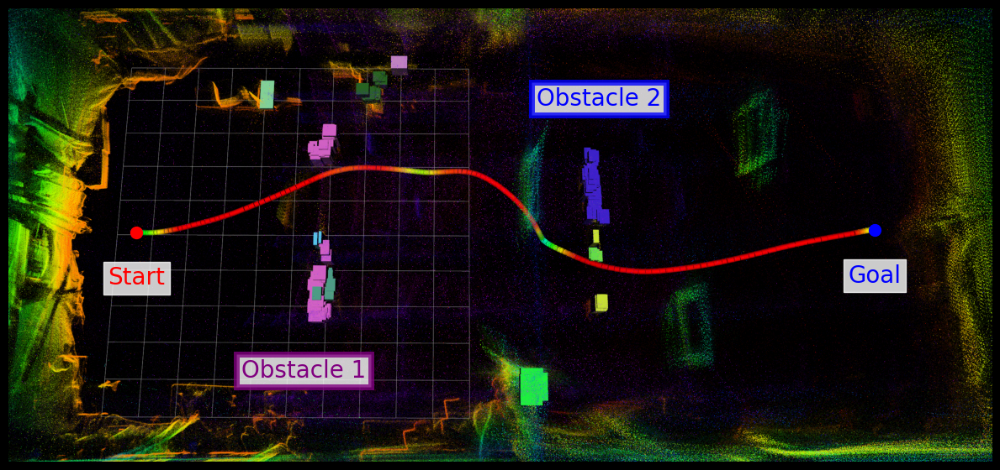

In [429]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
plt.style.use('dark_background')
# Load images
folder_path = "/media/kkondo/T7/dynus/tro_paper/hardware/uav/dynamic/num_4_folder"
image = plt.imread(folder_path + '/uav_hw_dynamic_num_4.png')

# Create a figure with GridSpec layout
fig_size_x = 12
fig_size_y = fig_size_x * 0.9
fig, ax = plt.subplots(figsize=(fig_size_x, fig_size_y))

# crop the images and create camera and actual path images from one image
image = image[600:image.shape[0]-300, 700:image.shape[1]-400]

# Just plot cropped image
ax.imshow(image)
ax.axis('off')

# Add a dot to indicate the start point
ax.scatter(0.13, 0.505, s=100, c='red', marker='o', transform=ax.transAxes)
# add a red text "start point"
ax.text(0.13, 0.405, "Start",
        ha='center', va='center', transform=ax.transAxes,
        bbox = dict(facecolor='white', alpha=0.8, edgecolor='white'),
        fontsize=20, color='red')
# Add a dot to indicate the end point
ax.scatter(0.88, 0.51, s=100, c='blue', marker='o', transform=ax.transAxes)
# add a blue text "end point"
ax.text(0.88, 0.41, "Goal",
        ha='center', va='center', transform=ax.transAxes,
        bbox = dict(facecolor='white', alpha=0.8, edgecolor='white'),
        fontsize=20, color='blue')

ax.text(0.3, 0.2, "Obstacle 1",
                ha='center', va='center', transform=ax.transAxes,
                bbox=dict(facecolor='white', alpha=0.8, edgecolor='purple', linewidth=5),
                fontsize=20, color='purple')
ax.text(0.6, 0.8, "Obstacle 2",
                ha='center', va='center', transform=ax.transAxes,
                bbox=dict(facecolor='white', alpha=0.8, edgecolor='blue', linewidth=5),
                fontsize=20, color='blue')

plt.tight_layout()

# Save the figure if SAVE is True
plt.savefig("/media/kkondo/T7/dynus/tro_paper/hardware/uav/dynamic/num_4_folder/rviz_overhead.png", bbox_inches='tight', dpi=300)
plt.show()

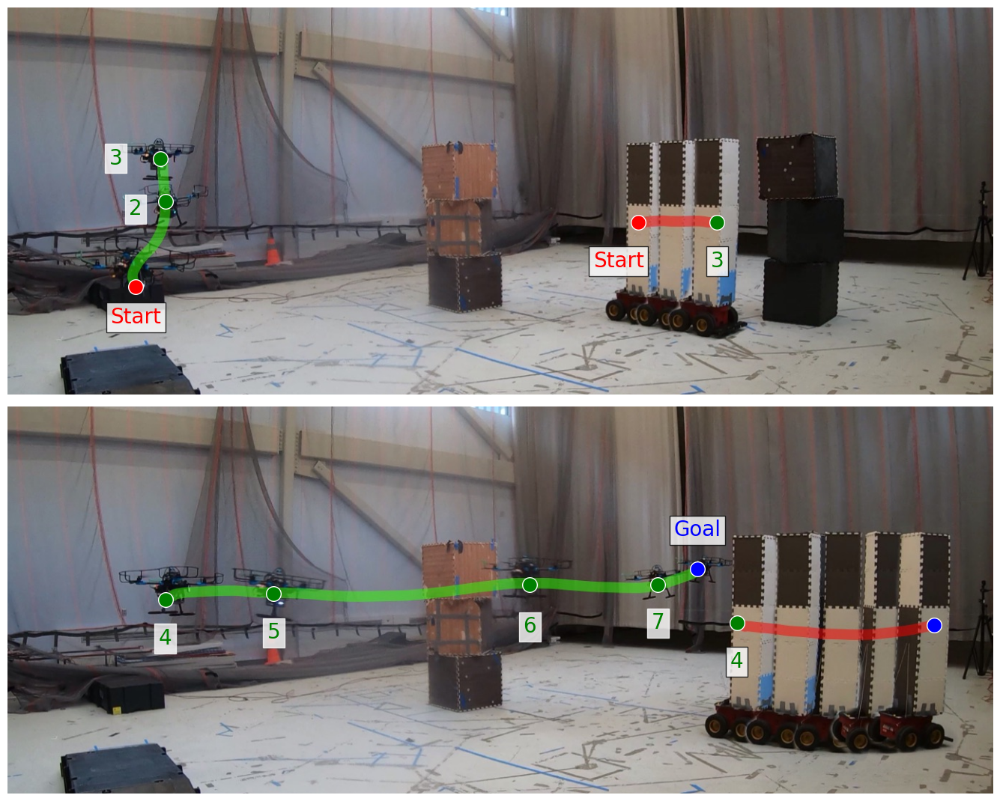

In [429]:
import matplotlib.pyplot as plt
import os

plt.style.use('default')

# Folder path
folder_path = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_0"

# Load images
image1 = plt.imread(os.path.join(folder_path, 'seg1-goodnoted.jpg'))
image2 = plt.imread(os.path.join(folder_path, 'seg2-goodnoted.jpg'))  # NEW IMAGE

# Crop both images (adjust as needed)
image1 = image1[200:image1.shape[0]-200, 100:image1.shape[1]-200]
image2 = image2[200:image2.shape[0]-200, 100:image2.shape[1]-200]

# Create side-by-side figure
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(24, 10.8))  # Wide figure

# ---------- First subplot ----------
ax1.imshow(image1)
ax1.axis('off')

# Start point
ax1.scatter(0.13, 0.28, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.13, 0.2, "Start", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='red')

# Green agent dots
ax1.scatter(0.16, 0.5, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.scatter(0.155, 0.61, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.13, 0.48, "2", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.11, 0.61, "3", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Obstacles
ax1.scatter(0.64, 0.445, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolors='white')
ax1.scatter(0.72, 0.445, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.62, 0.345, "Start", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='red')
ax1.text(0.72, 0.345, "3", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')

# ---------- Second subplot (New Image) ----------
ax2.imshow(image2)
ax2.axis('off')

# Green agent dots
ax2.scatter(0.16, 0.5, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.scatter(0.27, 0.515, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.scatter(0.53, 0.54, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.scatter(0.66, 0.54, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.text(0.16, 0.4, "4", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.27, 0.415, "5", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.53, 0.43, "6", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.66, 0.44, "7", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Add a dot to indicate the end point
ax2.scatter(0.7, 0.58, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')
# add a blue text "end point"
ax2.text(0.7, 0.68, "Goal", ha='center', va='center', transform=ax2.transAxes, bbox = dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='blue')

# Obstacles
ax2.scatter(0.74, 0.44, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolors='white')
ax2.text(0.74, 0.34, "4", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')
ax2.scatter(0.94, 0.435, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')

plt.tight_layout()
plt.savefig(os.path.join(folder_path, "num0_combined.png"), bbox_inches='tight', dpi=500)
plt.show()


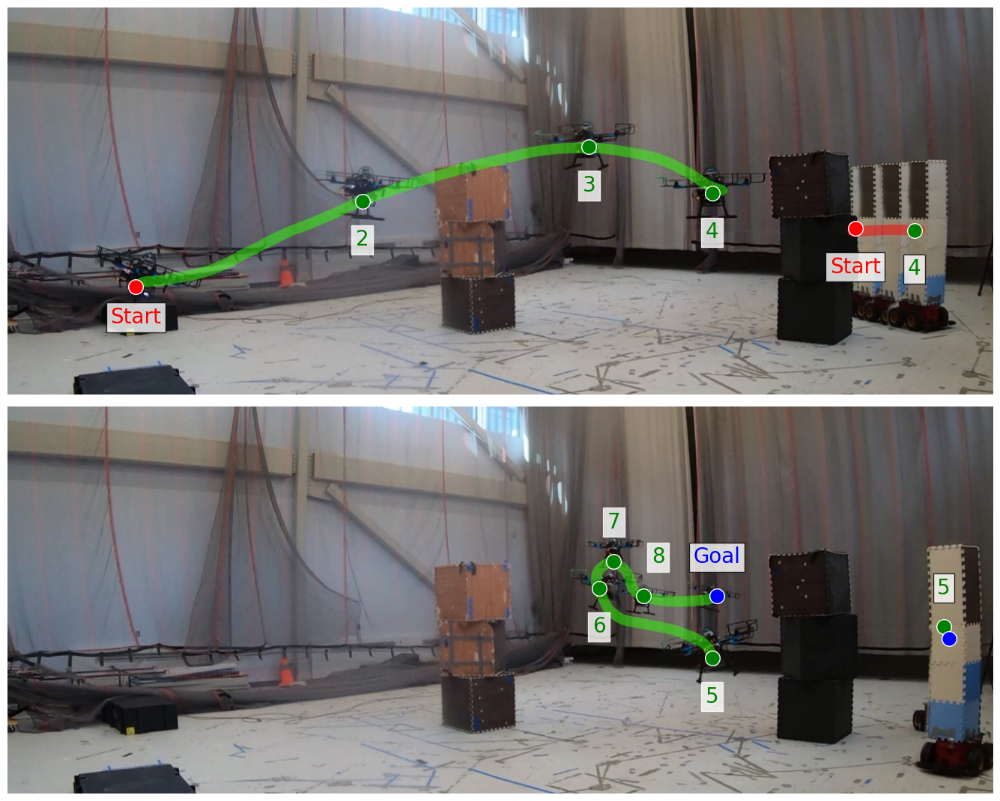

In [430]:
import matplotlib.pyplot as plt
import os

plt.style.use('default')

# Folder path
folder_path = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_1"

# Load images
image1 = plt.imread(os.path.join(folder_path, 'seg1_goodnoted.jpg'))
image2 = plt.imread(os.path.join(folder_path, 'seg2_goodnoted.jpg'))  # NEW IMAGE

# Crop both images (adjust as needed)
image1 = image1[200:image1.shape[0]-200, 100:image1.shape[1]-200]
image2 = image2[200:image2.shape[0]-200, 100:image2.shape[1]-200]

# Create side-by-side figure
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(24, 10.8))  # Wide figure

# ---------- First subplot ----------
ax1.imshow(image1)
ax1.axis('off')

# Start point
ax1.scatter(0.13, 0.28, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.13, 0.2, "Start", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='red')

# Green agent dots
ax1.scatter(0.36, 0.5, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #2
ax1.scatter(0.59, 0.64, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #3
ax1.scatter(0.715, 0.52, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #4
ax1.text(0.36, 0.4, "2", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.59, 0.54, "3", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.715, 0.42, "4", ha='center', va='center', transform=ax1.transAxes,
            bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Obstacles
ax1.scatter(0.86, 0.43, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolors='white')
ax1.scatter(0.92, 0.425, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.86, 0.33, "Start", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='red')
ax1.text(0.92, 0.325, "4", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')

# ---------- Second subplot (New Image) ----------
ax2.imshow(image2)
ax2.axis('off')

# Green agent dots
ax2.scatter(0.715, 0.35, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #3
ax2.scatter(0.6, 0.53, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #4
ax2.scatter(0.615, 0.6, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #5
ax2.scatter(0.645, 0.51, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #6

ax2.text(0.715, 0.25, "5", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.6, 0.43, "6", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.615, 0.7, "7", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.66, 0.61, "8", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Add a dot to indicate the end point
ax2.scatter(0.72, 0.51, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')
# add a blue text "end point"
ax2.text(0.72, 0.61, "Goal", ha='center', va='center', transform=ax2.transAxes, bbox = dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='blue')

# Obstacles
ax2.scatter(0.95, 0.43, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.text(0.95, 0.53, "5", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')
ax2.scatter(0.955, 0.40, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')

plt.tight_layout()
plt.savefig(os.path.join(folder_path, "num1_combined.png"), bbox_inches='tight', dpi=500)
# plt.show()


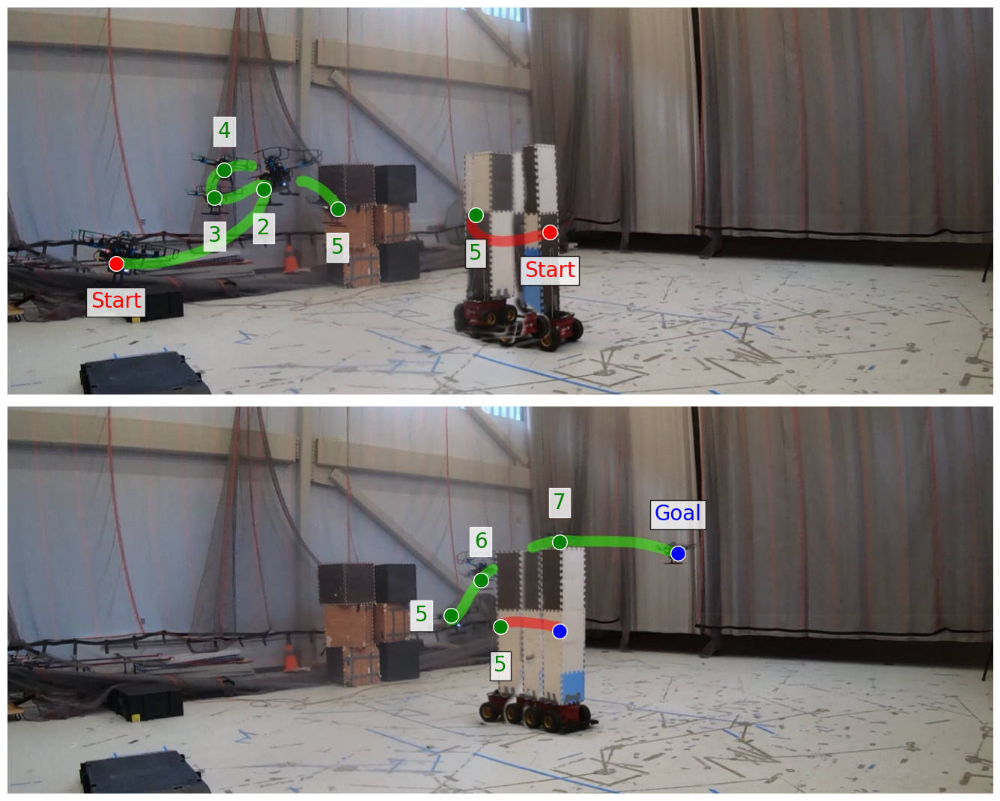

In [202]:
import matplotlib.pyplot as plt
import os

plt.style.use('default')

# Folder path
folder_path = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_2"

# Load images
image1 = plt.imread(os.path.join(folder_path, 'seg1_goodnoted.jpg'))
image2 = plt.imread(os.path.join(folder_path, 'seg2_goodnoted.jpg'))  # NEW IMAGE

# Crop both images (adjust as needed)
image1 = image1[200:image1.shape[0]-200, 100:image1.shape[1]-200]
image2 = image2[200:image2.shape[0]-200, 100:image2.shape[1]-200]

# Create side-by-side figure
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(24, 10.8))  # Wide figure

# ---------- First subplot ----------
ax1.imshow(image1)
ax1.axis('off')

# Start point
ax1.scatter(0.11, 0.34, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.11, 0.24, "Start", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='red')

# Green agent dots
ax1.scatter(0.26, 0.53, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #2
ax1.scatter(0.21, 0.51, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #3
ax1.scatter(0.22, 0.58, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #4
ax1.scatter(0.335, 0.48, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #4
ax1.text(0.26, 0.43, "2", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.21, 0.41, "3", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.22, 0.68, "4", ha='center', va='center', transform=ax1.transAxes,
            bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.335, 0.38, "5", ha='center', va='center', transform=ax1.transAxes,
            bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Obstacles
ax1.scatter(0.55, 0.42, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolors='white')
ax1.scatter(0.475, 0.465, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.55, 0.32, "Start", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='red')
ax1.text(0.475, 0.365, "5", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')

# ---------- Second subplot (New Image) ----------
ax2.imshow(image2)
ax2.axis('off')

# Green agent dots
ax2.scatter(0.45, 0.46, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #3
ax2.scatter(0.48, 0.55, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #4
ax2.scatter(0.56, 0.65, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #5

ax2.text(0.42, 0.46, "5", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.48, 0.65, "6", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.56, 0.75, "7", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Add a dot to indicate the end point
ax2.scatter(0.68, 0.62, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')
# add a blue text "end point"
ax2.text(0.68, 0.72, "Goal", ha='center', va='center', transform=ax2.transAxes, bbox = dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='blue')

# Obstacles
ax2.scatter(0.5, 0.43, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.text(0.5, 0.33, "5", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')
ax2.scatter(0.56, 0.42, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')

plt.tight_layout()
plt.savefig(os.path.join(folder_path, "num2_combined.png"), bbox_inches='tight', dpi=500)
# plt.show()


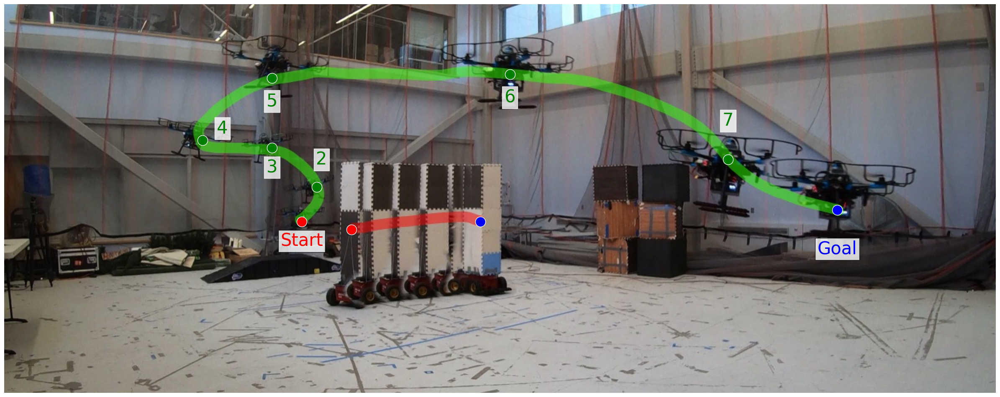

In [233]:
import matplotlib.pyplot as plt
import os

plt.style.use('default')

# Folder path
folder_path = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_3"

# Load images
image1 = plt.imread(os.path.join(folder_path, 'seg1_goodnoted.jpg'))

# Crop both images (adjust as needed)
image1 = image1[200:image1.shape[0]-200, 100:image1.shape[1]-200]

# Create side-by-side figure
fig, ax1 = plt.subplots(1, 1, figsize=(24, 10.8))  # Wide figure

# ---------- First subplot ----------
ax1.imshow(image1)
ax1.axis('off')

# Start point
ax1.scatter(0.3, 0.44, s=300, c='red', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.3, 0.39, "Start", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=30, color='red')

# Green agent dots
ax1.scatter(0.315, 0.53, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #2
ax1.scatter(0.27, 0.63, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #3
ax1.scatter(0.2, 0.65, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #4
ax1.scatter(0.27, 0.81, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #5
ax1.scatter(0.51, 0.82, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #6
ax1.scatter(0.73, 0.6, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #7
ax1.scatter(0.84, 0.47, s=300, c='blue', marker='o', transform=ax1.transAxes, edgecolor='white') #goal
ax1.text(0.32, 0.6, "2", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.27, 0.58, "3", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.22, 0.68, "4", ha='center', va='center', transform=ax1.transAxes,
            bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.27, 0.75, "5", ha='center', va='center', transform=ax1.transAxes,
            bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.51, 0.76, "6", ha='center', va='center', transform=ax1.transAxes,
            bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.73, 0.7, "7", ha='center', va='center', transform=ax1.transAxes,
            bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.84, 0.37, "Goal", ha='center', va='center', transform=ax1.transAxes, bbox = dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=30, color='blue')

# Obstacles
ax1.scatter(0.35, 0.42, s=300, c='red', marker='o', transform=ax1.transAxes, edgecolors='white')
ax1.scatter(0.48, 0.44, s=300, c='blue', marker='o', transform=ax1.transAxes, edgecolor='white')

plt.tight_layout()
plt.savefig(os.path.join(folder_path, "num3_combined.png"), bbox_inches='tight', dpi=500)
# plt.show()


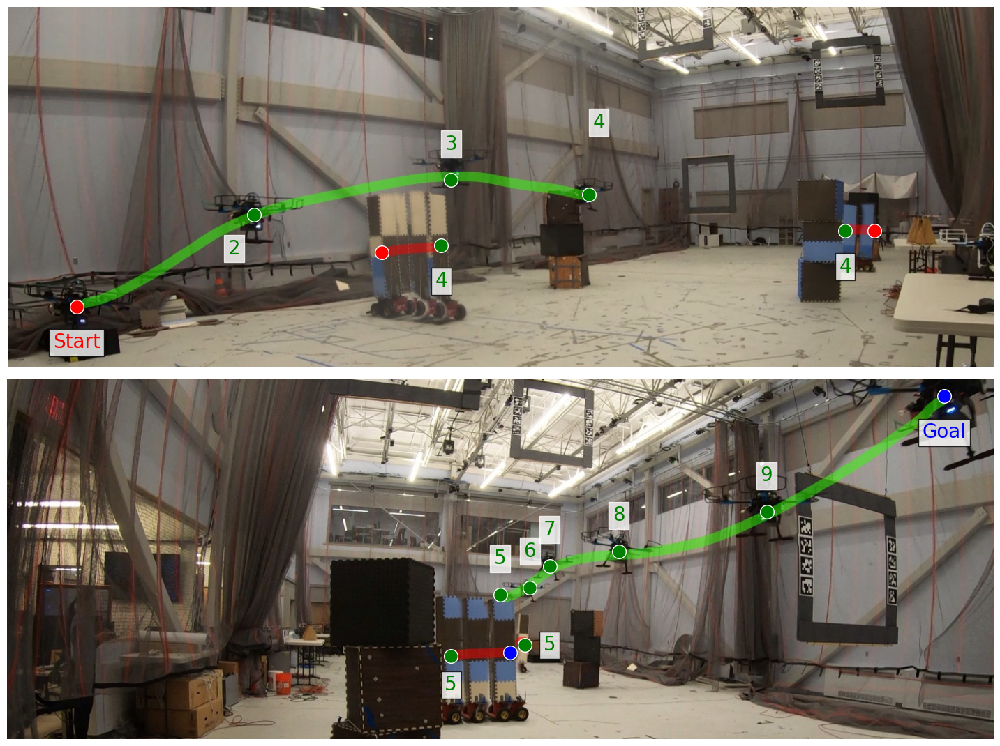

In [277]:
import matplotlib.pyplot as plt
import os

plt.style.use('default')

# Folder path
folder_path = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_4"

# Load images
image1 = plt.imread(os.path.join(folder_path, 'seg1_goodnoted.jpg'))
image2 = plt.imread(os.path.join(folder_path, 'seg2_goodnoted.jpg'))  # NEW IMAGE

# Crop both images (adjust as needed)
image1 = image1[100:image1.shape[0]-300, 0:image1.shape[1]-200]
image2 = image2[100:image2.shape[0]-300, 0:image2.shape[1]-200]

# Create side-by-side figure
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(24, 10.8))  # Wide figure

# ---------- First subplot ----------
ax1.imshow(image1)
ax1.axis('off')

# Start point
ax1.scatter(0.07, 0.17, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.07, 0.07, "Start", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='red')

# Green agent dots
ax1.scatter(0.25, 0.425, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #2
ax1.scatter(0.45, 0.52, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #3
ax1.scatter(0.59, 0.48, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #4
ax1.text(0.23, 0.33, "2", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.45, 0.62, "3", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.6, 0.68, "4", ha='center', va='center', transform=ax1.transAxes,
            bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Obstacles
ax1.scatter(0.38, 0.32, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolors='white')
ax1.scatter(0.44, 0.34, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.44, 0.24, "4", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')

ax1.scatter(0.88, 0.38, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolors='white')
ax1.scatter(0.85, 0.38, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.85, 0.28, "4", ha='center', va='center', transform=ax1.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')

# ---------- Second subplot (New Image) ----------
ax2.imshow(image2)
ax2.axis('off')

# Green agent dots
ax2.scatter(0.5, 0.4, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #3
ax2.scatter(0.53, 0.42, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #3
ax2.scatter(0.55, 0.48, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #4
ax2.scatter(0.62, 0.52, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #5
ax2.scatter(0.77, 0.63, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #5

ax2.text(0.5, 0.5, "5", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.53, 0.52, "6", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.55, 0.58, "7", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.62, 0.62, "8", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.77, 0.73, "9", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Add a dot to indicate the end point
ax2.scatter(0.95, 0.95, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')
# add a blue text "end point"
ax2.text(0.95, 0.85, "Goal", ha='center', va='center', transform=ax2.transAxes, bbox = dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='blue')

# Obstacles
ax2.scatter(0.45, 0.23, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.text(0.45, 0.15, "5", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')
ax2.scatter(0.51, 0.24, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')

ax2.scatter(0.525, 0.26, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.text(0.55, 0.26, "5", ha='center', va='center', transform=ax2.transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')

plt.tight_layout()
plt.savefig(os.path.join(folder_path, "num4_combined.png"), bbox_inches='tight', dpi=500)
# plt.show()


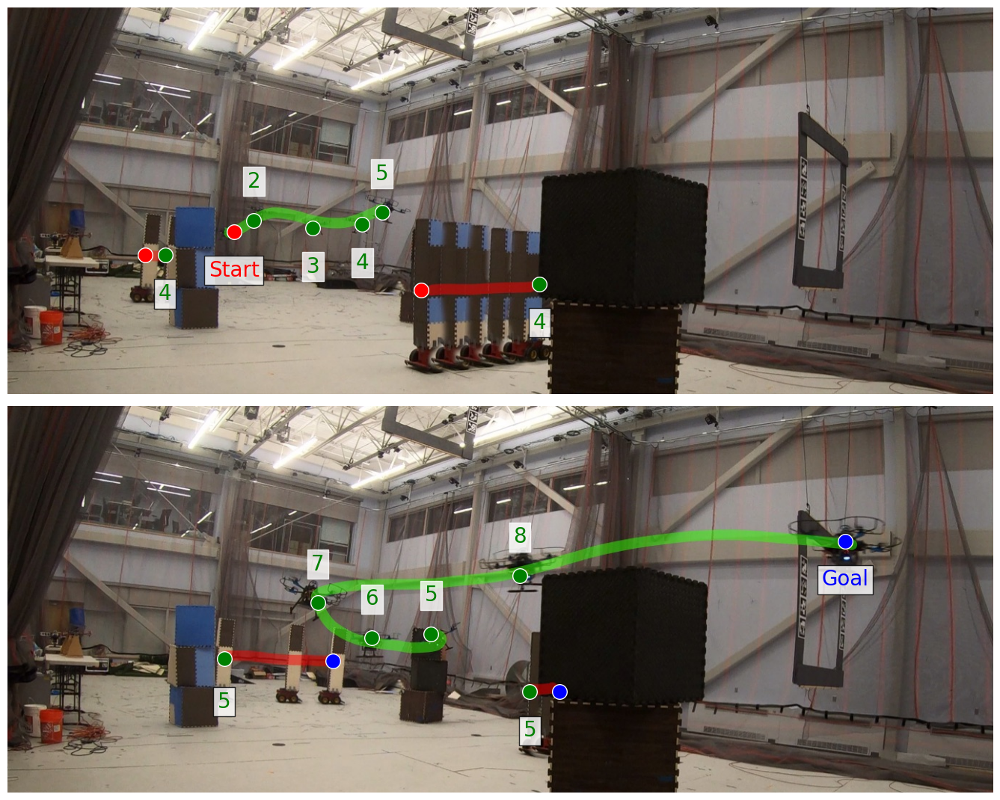

In [313]:
import matplotlib.pyplot as plt
import os

plt.style.use('default')

# Folder path
folder_path = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_5"

# Load images
image1 = plt.imread(os.path.join(folder_path, 'seg1_goodnoted.jpg'))
image2 = plt.imread(os.path.join(folder_path, 'seg2_goodnoted.jpg'))  # NEW IMAGE

# Crop both images (adjust as needed)
image1 = image1[100:image1.shape[0]-300, 0:image1.shape[1]-300]
image2 = image2[100:image2.shape[0]-300, 0:image2.shape[1]-300]

# Create side-by-side figure
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(24, 10.8))  # Wide figure

# ---------- First subplot ----------
ax1.imshow(image1)
ax1.axis('off')

# Start point
ax1.scatter(0.23, 0.42, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.23, 0.32, "Start", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='red')

# Green agent dots
ax1.scatter(0.25, 0.45, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #2
ax1.scatter(0.31, 0.43, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #3
ax1.scatter(0.36, 0.44, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #4
ax1.scatter(0.38, 0.47, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #4
ax1.text(0.25, 0.55, "2", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.31, 0.33, "3", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.36, 0.34, "4", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.38, 0.57, "5", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Obstacles
ax1.scatter(0.42, 0.27, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolors='white')
ax1.scatter(0.54, 0.285, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.54, 0.185, "4", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')

ax1.scatter(0.14, 0.36, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolors='white')
ax1.scatter(0.16, 0.36, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.16, 0.26, "4", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')

# ---------- Second subplot (New Image) ----------
ax2.imshow(image2)
ax2.axis('off')

# Green agent dots
ax2.scatter(0.43, 0.41, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #3
ax2.scatter(0.37, 0.4, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #3
ax2.scatter(0.315, 0.49, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #4
ax2.scatter(0.52, 0.56, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #5

ax2.text(0.43, 0.51, "5", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.37, 0.5, "6", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.315, 0.59, "7", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.52, 0.66, "8", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Add a dot to indicate the end point
ax2.scatter(0.85, 0.65, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')
# add a blue text "end point"
ax2.text(0.85, 0.55, "Goal", ha='center', va='center', transform=ax2.transAxes, bbox = dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='blue')

# Obstacles
ax2.scatter(0.53, 0.26, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.text(0.53, 0.16, "5", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')
ax2.scatter(0.56, 0.26, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')

ax2.scatter(0.22, 0.345, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.text(0.22, 0.2345, "5", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')
ax2.scatter(0.33, 0.34, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')

plt.tight_layout()
plt.savefig(os.path.join(folder_path, "num5_combined.png"), bbox_inches='tight', dpi=500)
# plt.show()


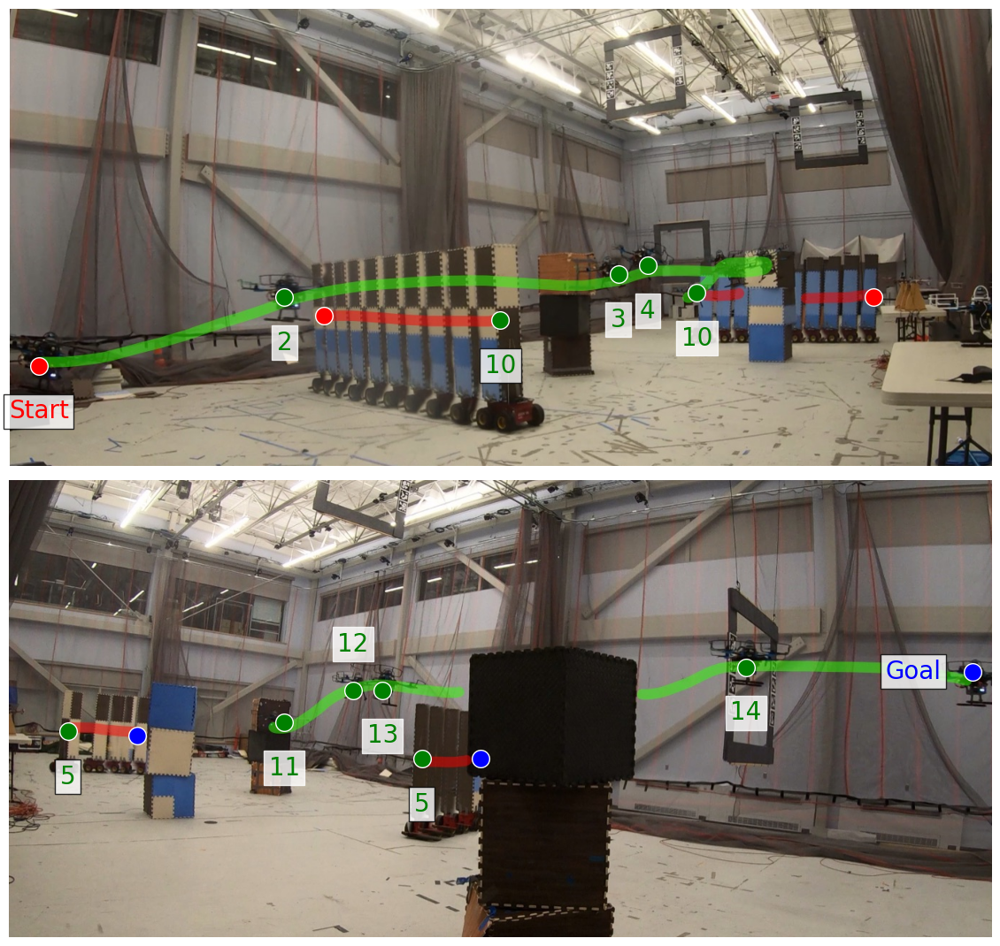

In [355]:
import matplotlib.pyplot as plt
import os

plt.style.use('default')

# Folder path
folder_path = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_6"

# Load images
image1 = plt.imread(os.path.join(folder_path, 'seg1_goodnoted.jpg'))
image2 = plt.imread(os.path.join(folder_path, 'seg2_goodnoted.jpg'))  # NEW IMAGE

# Crop both images (adjust as needed)
image1 = image1[100:image1.shape[0]-200, 100:image1.shape[1]-200]
image2 = image2[100:image2.shape[0]-200, 100:image2.shape[1]-200]

# Create side-by-side figure
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(24, 10.8))  # Wide figure

# ---------- First subplot ----------
ax1.imshow(image1)
ax1.axis('off')

# Start point
ax1.scatter(0.03, 0.22, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.03, 0.12, "Start", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='red')

# Green agent dots
ax1.scatter(0.28, 0.37, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #2
ax1.scatter(0.62, 0.42, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #3
ax1.scatter(0.65, 0.44, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #4
ax1.scatter(0.7, 0.38, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #10
ax1.text(0.28, 0.27, "2", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.62, 0.32, "3", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.65, 0.34, "4", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.7, 0.28, "10", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Obstacles
ax1.scatter(0.32, 0.33, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolors='white')
ax1.scatter(0.5, 0.32, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.5, 0.22, "10", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')

ax1.scatter(0.88, 0.37, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolors='white')
# ax1.scatter(0.16, 0.36, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
# ax1.text(0.16, 0.26, "4", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')

# ---------- Second subplot (New Image) ----------
ax2.imshow(image2)
ax2.axis('off')

# Green agent dots
ax2.scatter(0.28, 0.47, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #3
ax2.scatter(0.35, 0.54, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #3
ax2.scatter(0.38, 0.54, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #3
ax2.scatter(0.75, 0.59, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #4

ax2.text(0.28, 0.37, "11", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.35, 0.64, "12", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.38, 0.44, "13", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.75, 0.49, "14", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Add a dot to indicate the end point
ax2.scatter(0.98, 0.58, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')
# add a blue text "end point"
ax2.text(0.92, 0.58, "Goal", ha='center', va='center', transform=ax2.transAxes, bbox = dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='blue')

# Obstacles
ax2.scatter(0.06, 0.45, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.text(0.06, 0.35, "5", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')
ax2.scatter(0.13, 0.44, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')

ax2.scatter(0.42, 0.39, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.text(0.42, 0.29, "5", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')
ax2.scatter(0.48, 0.39, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')

plt.tight_layout()
plt.savefig(os.path.join(folder_path, "num6_combined.png"), bbox_inches='tight', dpi=500)
# plt.show()


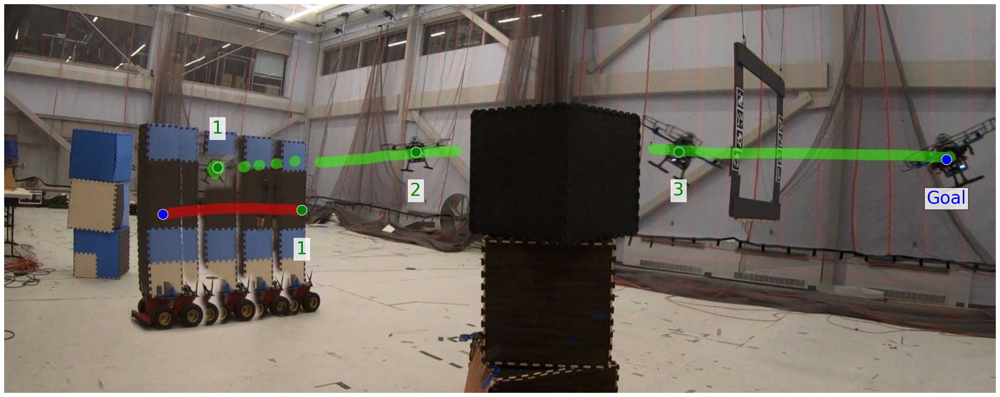

In [366]:
import matplotlib.pyplot as plt
import os

plt.style.use('default')

# Folder path
folder_path = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_7"

# Load images
image1 = plt.imread(os.path.join(folder_path, 'seg1_goodnoted.jpg'))

# Crop both images (adjust as needed)
image1 = image1[200:image1.shape[0]-200, 100:image1.shape[1]-200]

# Create side-by-side figure
fig, ax1 = plt.subplots(1, 1, figsize=(24, 10.8))  # Wide figure

# ---------- First subplot ----------
ax1.imshow(image1)
ax1.axis('off')

# Green agent dots
ax1.scatter(0.215, 0.58, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #3
ax1.scatter(0.415, 0.62, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #4
ax1.scatter(0.68, 0.62, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #5
ax1.scatter(0.95, 0.6, s=300, c='blue', marker='o', transform=ax1.transAxes, edgecolor='white') #goal
ax1.text(0.215, 0.68, "1", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.415, 0.52, "2", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.68, 0.52, "3", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.95, 0.5, "Goal", ha='center', va='center', transform=ax1.transAxes, bbox = dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=30, color='blue')

# Obstacles
ax1.scatter(0.3, 0.47, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolors='white')
ax1.text(0.3, 0.37, "1", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.scatter(0.16, 0.46, s=300, c='blue', marker='o', transform=ax1.transAxes, edgecolor='white')

plt.tight_layout()
plt.savefig(os.path.join(folder_path, "num7_combined.png"), bbox_inches='tight', dpi=500)
# plt.show()


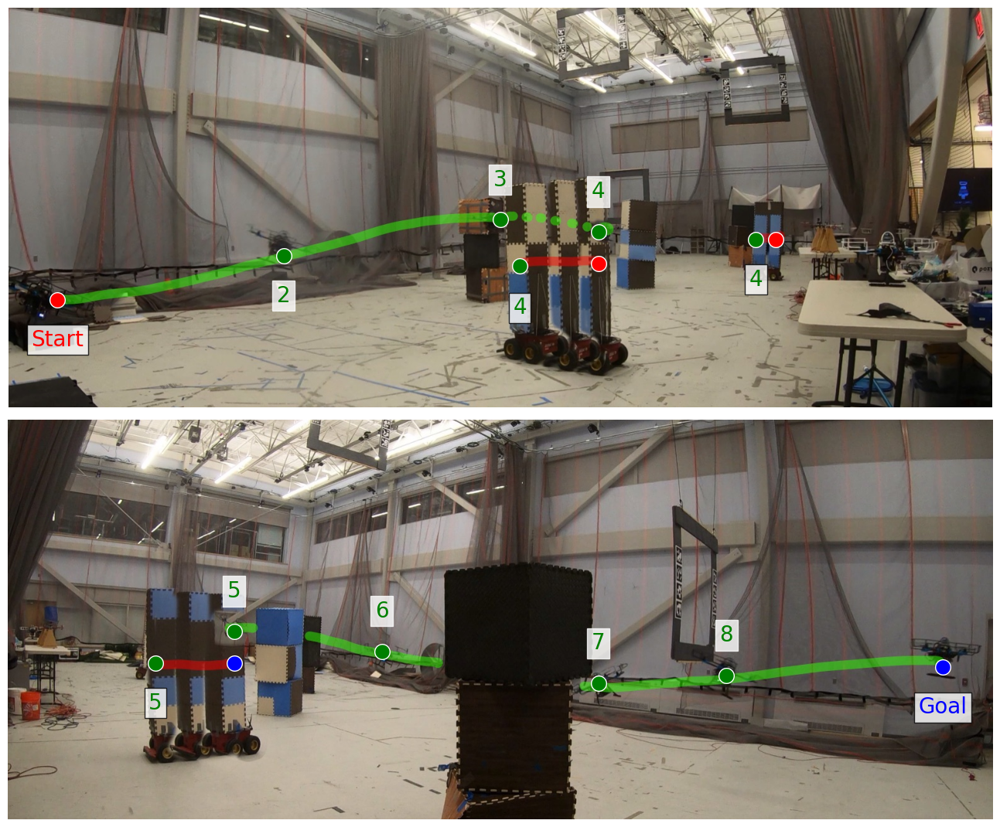

In [397]:
import matplotlib.pyplot as plt
import os

plt.style.use('default')

# Folder path
folder_path = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_8"

# Load images
image1 = plt.imread(os.path.join(folder_path, 'seg1_goodnoted.jpg'))
image2 = plt.imread(os.path.join(folder_path, 'seg2_goodnoted.jpg'))  # NEW IMAGE

# Crop both images (adjust as needed)
image1 = image1[100:image1.shape[0]-200, 100:image1.shape[1]-0]
image2 = image2[100:image2.shape[0]-200, 100:image2.shape[1]-0]

# Create side-by-side figure
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(24, 10.8))  # Wide figure

# ---------- First subplot ----------
ax1.imshow(image1)
ax1.axis('off')

# Start point
ax1.scatter(0.05, 0.27, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.05, 0.17, "Start", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='red')

# Green agent dots
ax1.scatter(0.28, 0.38, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #2
ax1.scatter(0.5, 0.47, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #3
ax1.scatter(0.6, 0.44, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #4
ax1.text(0.28, 0.28, "2", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.5, 0.57, "3", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax1.text(0.6, 0.54, "4", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Obstacles
ax1.scatter(0.6, 0.36, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolors='white')
ax1.scatter(0.52, 0.355, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.52, 0.25, "4", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')

ax1.scatter(0.78, 0.42, s=200, c='red', marker='o', transform=ax1.transAxes, edgecolors='white')
ax1.scatter(0.76, 0.42, s=200, c='green', marker='o', transform=ax1.transAxes, edgecolor='white')
ax1.text(0.76, 0.32, "4", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')

# ---------- Second subplot (New Image) ----------
ax2.imshow(image2)
ax2.axis('off')

# Green agent dots
ax2.scatter(0.23, 0.47, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #3
ax2.scatter(0.38, 0.42, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #4
ax2.scatter(0.6, 0.34, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #5
ax2.scatter(0.73, 0.36, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white') #6

ax2.text(0.23, 0.57, "5", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.38, 0.52, "6", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.6, 0.44, "7", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')
ax2.text(0.73, 0.46, "8", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=20, color='green')

# Add a dot to indicate the end point
ax2.scatter(0.95, 0.38, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')
# add a blue text "end point"
ax2.text(0.95, 0.28, "Goal", ha='center', va='center', transform=ax2.transAxes, bbox = dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='blue')

# Obstacles
ax2.scatter(0.15, 0.39, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
ax2.text(0.15, 0.29, "5", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')
ax2.scatter(0.23, 0.39, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')

# ax2.scatter(0.42, 0.39, s=200, c='green', marker='o', transform=ax2.transAxes, edgecolor='white')
# ax2.text(0.42, 0.29, "5", ha='center', va='center', transform=ax2.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=20, color='green')
# ax2.scatter(0.48, 0.39, s=200, c='blue', marker='o', transform=ax2.transAxes, edgecolors='white')

plt.tight_layout()
plt.savefig(os.path.join(folder_path, "num8_combined.png"), bbox_inches='tight', dpi=500)
# plt.show()


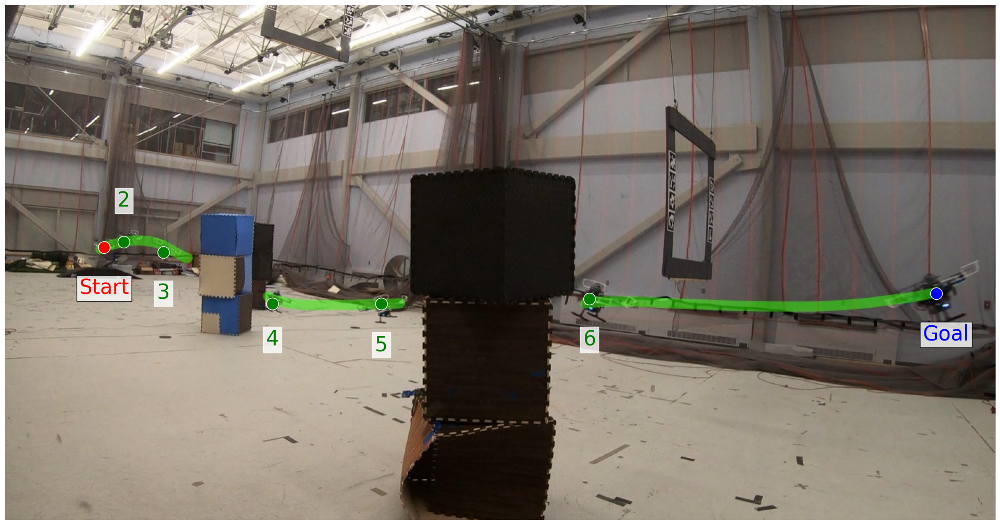

In [428]:
import matplotlib.pyplot as plt
import os

plt.style.use('default')

# Folder path
folder_path = "/home/kkondo/MIT Dropbox/Kota Kondo/Research/MIT/dynus/uav_dyn_sta/num_9"

# Load images
image1 = plt.imread(os.path.join(folder_path, 'seg1_goodnoted.jpg'))

# Crop both images (adjust as needed)
image1 = image1[100:image1.shape[0]-100, 200:image1.shape[1]-50]

# Create side-by-side figure
fig, ax1 = plt.subplots(1, 1, figsize=(24, 10.8))  # Wide figure

# ---------- First subplot ----------
ax1.imshow(image1)
ax1.axis('off')

# Green agent dots
ax1.scatter(0.1, 0.53, s=300, c='red', marker='o', transform=ax1.transAxes, edgecolor='white') #1
ax1.scatter(0.12, 0.54, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #2
ax1.scatter(0.16, 0.52, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #3
ax1.scatter(0.27, 0.42, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #4
ax1.scatter(0.38, 0.42, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #5
ax1.scatter(0.59, 0.43, s=300, c='green', marker='o', transform=ax1.transAxes, edgecolor='white') #6
ax1.scatter(0.94, 0.44, s=300, c='blue', marker='o', transform=ax1.transAxes, edgecolor='white') #goal
ax1.text(0.1, 0.45, "Start", ha='center', va='center', transform=ax1.transAxes,bbox=dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=30, color='red')
ax1.text(0.12, 0.62, "2", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.16, 0.44, "3", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.27, 0.35, "4", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.38, 0.34, "5", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.59, 0.35, "6", ha='center', va='center', transform=ax1.transAxes, bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), fontsize=30, color='green')
ax1.text(0.95, 0.36, "Goal", ha='center', va='center', transform=ax1.transAxes, bbox = dict(facecolor='white', alpha=0.8, edgecolor='black'), fontsize=30, color='blue')

plt.tight_layout()
plt.savefig(os.path.join(folder_path, "num9_combined.png"), bbox_inches='tight', dpi=500)
# plt.show()
